In [1]:
from gbdxtools import Interface
gbdx = Interface()

from gbdxtools.task import env
from gbdxtools import CatalogImage, WV03_VNIR, WV03_SWIR  


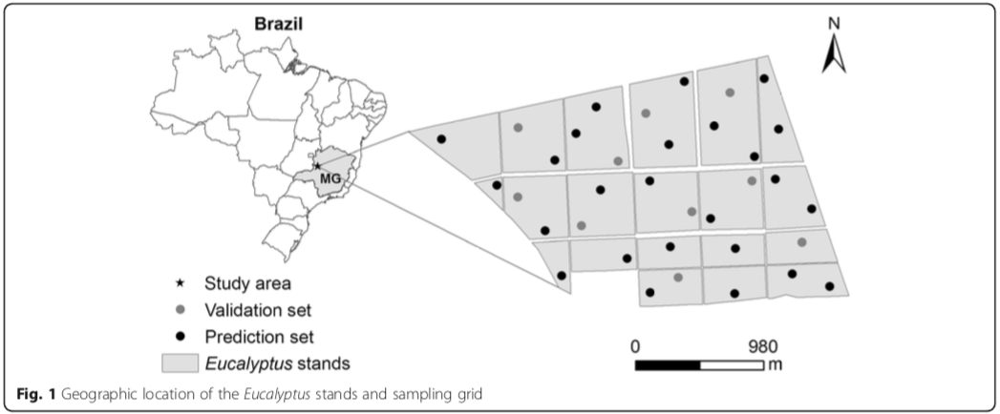

In [107]:
from IPython.display import Image
Image(filename='DosReisEucalyptStands.png') 

From Dos Reis, <i>et al.</i> (2018):

> The study was conducted in the municipality
> of Lassance, Minas Gerais, Brazil, within a 30 km
> radius from the centroid 17°56,647' S, 44°52,710' W
> and at about 800 m a.s.l. (Gerdau Florestal SA plantations).
> Leaf sampling was conducted in Apr 2014
> using commercial plantations of clonal Eucalyptus at
> 25 months old and established at a 7.0 × 1.3 m tree
> spacing. The soil at the experimental location was
> characterized as an Oxisol (Typic Hapludox) with a
> sandy loam texture.

> The Eucalyptus clonal stands under study are located in Lagoa Grande municipality,
> in the northwest of Minas Gerais state 
> (lat. 17° 43′ 00′′ S–17° 44′ 00′′ S, 
> long. 46° 32′ 00′′ W–46° 33′ 00′′ W, elevation 560 m a.s.l.) (Fig. 1).

In [2]:
#  https://www.latlong.net/c/?lat=-17.71666667&long=-46.53333333
# ordering 
cat_ids = ['103001006ABBE800']
order_id = gbdx.ordering.order(cat_ids)
print(order_id)  

d938f5fd-97ac-4f4b-a9af-63c11704da10


In [3]:
import pprint
pp = pprint.PrettyPrinter()

In [4]:
order_status = gbdx.ordering.status(order_id)
pp.pprint(order_status)

[{'acquisition_id': '103001006ABBE800',
  'location': 's3://receiving-dgcs-tdgplatform-com/058368933010_01_003',
  'state': 'delivered'}]


In [5]:
record = gbdx.catalog.get('103001006ABBE800')

In [6]:
record

{'identifier': '103001006ABBE800',
 'properties': {'browseURL': 'https://api.discover.digitalglobe.com/show?id=103001006ABBE800&f=jpeg',
  'catalogID': '103001006ABBE800',
  'cloudCover': 0,
  'footprintWkt': 'MULTIPOLYGON(((-46.67799733 -16.46760653, -46.48264024 -16.45271295, -46.48194777 -16.5005983, -46.48179229 -16.5486219, -46.48165816 -16.59666814, -46.48157535 -16.6446953, -46.48142046 -16.69268206, -46.48149725 -16.74071969, -46.48134116 -16.78866023, -46.48127821 -16.83663304, -46.4811239 -16.8845364, -46.48112675 -16.93248769, -46.48101752 -16.98040015, -46.48100881 -17.02831059, -46.48118155 -17.07626476, -46.480837 -17.12407194, -46.48077077 -17.17193173, -46.48066243 -17.21976277, -46.48051034 -17.26757716, -46.48041881 -17.31539263, -46.48034186 -17.36320692, -46.48023262 -17.41099966, -46.48031001 -17.45882967, -46.48021413 -17.50662239, -46.48004719 -17.55438494, -46.48011724 -17.60218382, -46.48006864 -17.64994126, -46.47996351 -17.69767518, -46.47992845 -17.7454356, 

In [2]:
import shapely
from shapely.geometry import Point
from shapely.geometry import Polygon
from shapely.geometry import MultiPolygon

x = Point( -46.54333333,-17.72666667).buffer(0.025)

from shapely import wkt

e = CatalogImage('103001006ABBE800', wkt=wkt.dumps(x))
print(wkt.dumps(x))

POLYGON ((-46.5183333300000044 -17.7266666700000002, -46.5184537118331960 -17.7291170985082402, -46.5188136979899198 -17.7315439280504030, -46.5194098216067005 -17.7339237869313635, -46.5202363416872231 -17.7362337558091276, -46.5212852983912910 -17.7384515884206486, -46.5225465896924391 -17.7405559258254897, -46.5240080686659354 -17.7425265021040914, -46.5256556604703420 -17.7443443395296647, -46.5274734978959117 -17.7459919313340677, -46.5294440741745134 -17.7474534103075641, -46.5315484115793510 -17.7487147016087086, -46.5337662441908790 -17.7497636583127836, -46.5360762130686396 -17.7505901783933062, -46.5384560719495965 -17.7511863020100797, -46.5408829014917629 -17.7515462881668036, -46.5433333300000029 -17.7516666699999988, -46.5457837585082430 -17.7515462881668036, -46.5482105880504093 -17.7511863020100797, -46.5505904469313663 -17.7505901783933062, -46.5529004158091269 -17.7497636583127836, -46.5551182484206549 -17.7487147016087086, -46.5572225858254924 -17.7474534103075641, -

In [14]:
de = CatalogImage('103001006ABBE800', wkt=wkt.dumps(x))

BadRequest: Problem fetching image metadata: status 403 , graph_id: 10500f0737acb60bcce12cbddb8bdbce70422e141b9bde23c8dac9f0c6f1eccb

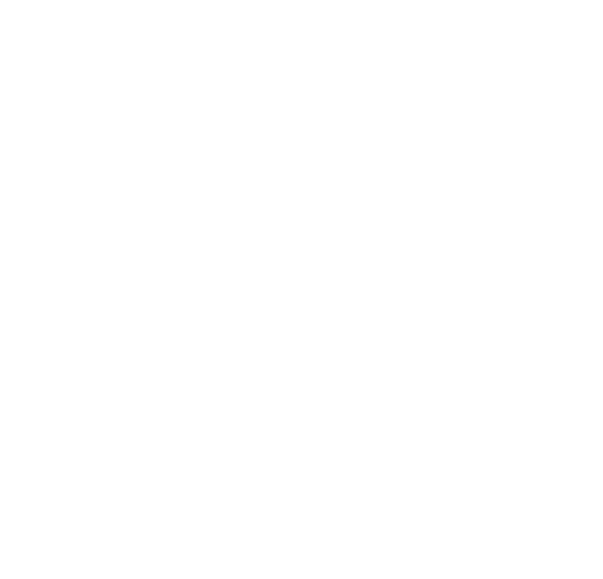

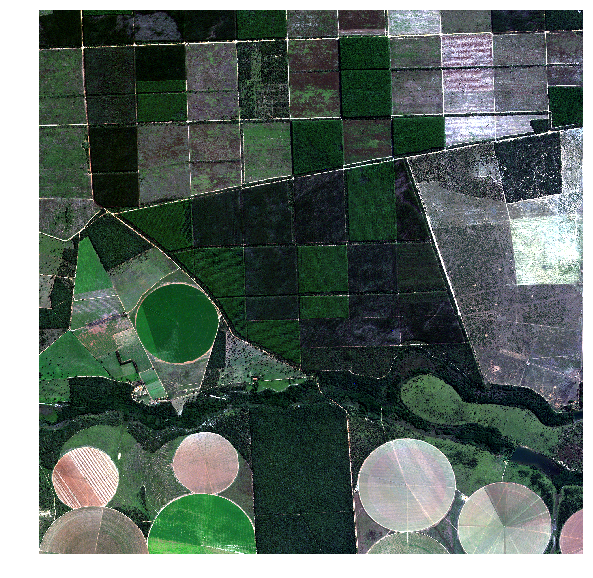

In [4]:
e.plot()

In [5]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

def plot(image, w=30, h=24, cmap='jet'):
    f, ax = plt.subplots(1, figsize=(w,h))
    ax.axis('off')
    plt.imshow(image, cmap=cmap)
    plt.colorbar()
    plt.show()

def climplot(image,lower,upper, w=30, h=24,  cmap='jet'):
    f, ax = plt.subplots(1, figsize=(w,h))
    ax.axis('off')
    plt.imshow(image, cmap=cmap)
    plt.colorbar()
    plt.clim(lower, upper)
    plt.show()

In [6]:
def ndvi(cimg):
    red = cimg[4,:,:]
    nir1 = cimg[6,:,:]
    return (nir1-red)/(nir1+red)

In [7]:
pndvi = ndvi(e)

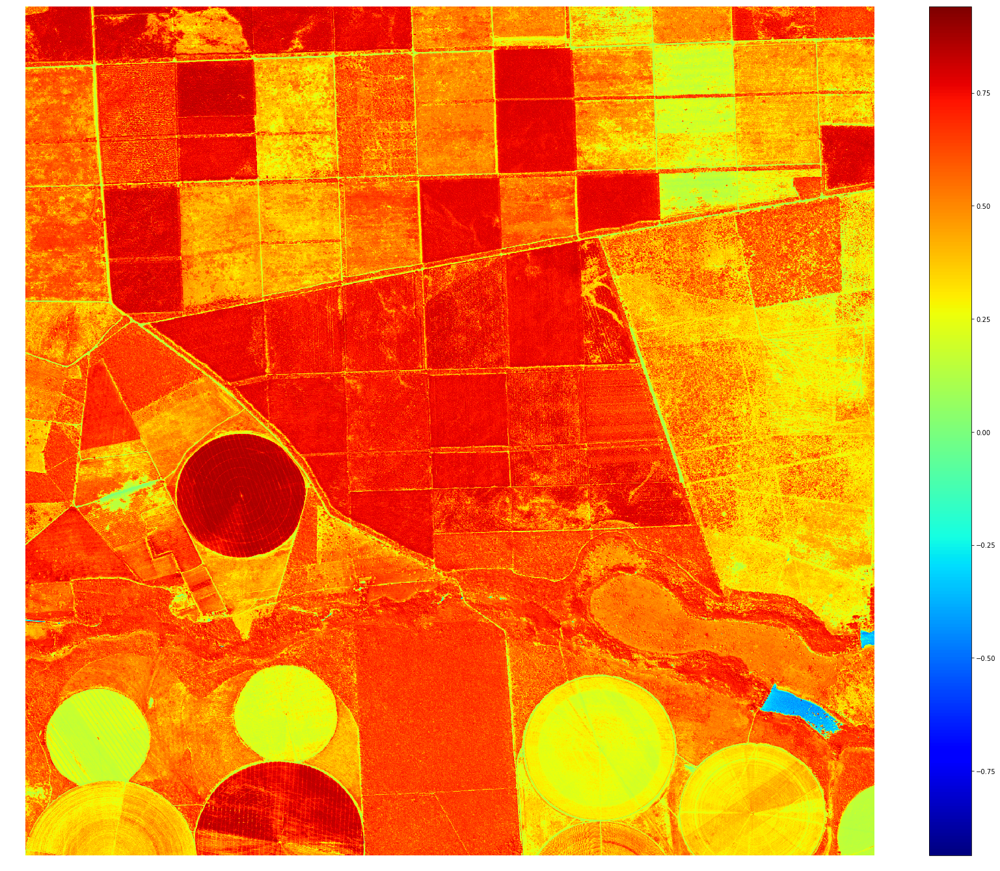

In [8]:
plot(pndvi)

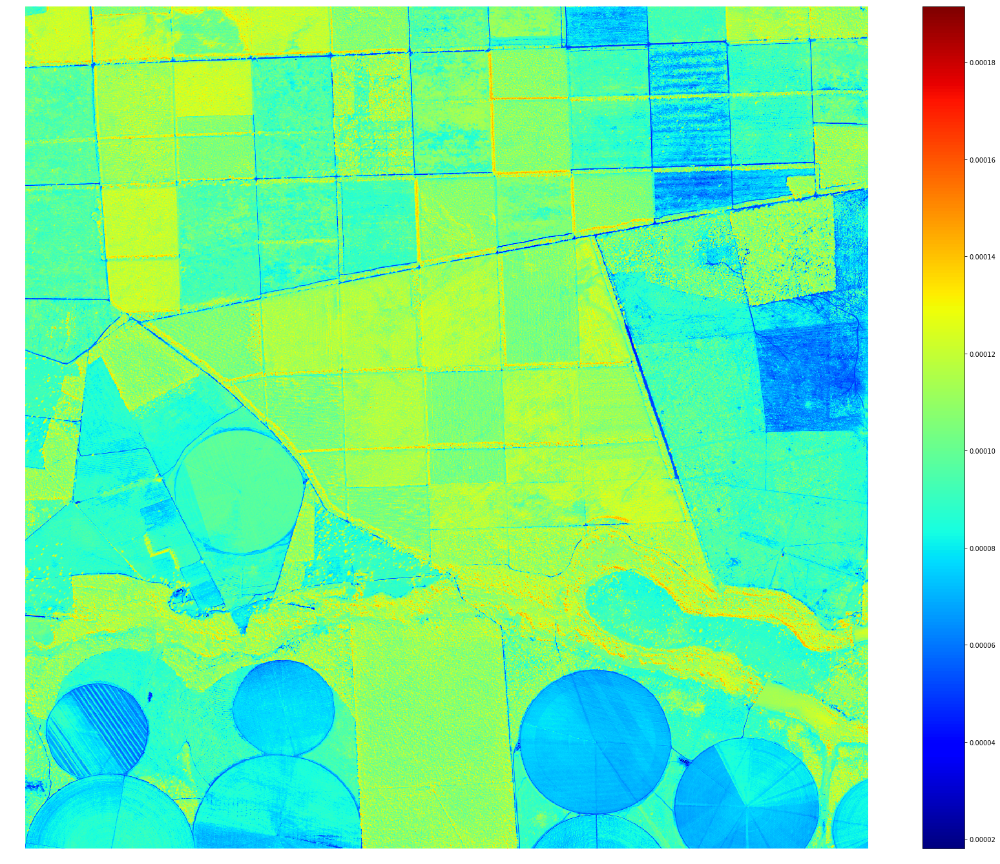

In [53]:
bands = ["coastal","Blue", "Green", "Yellow","red", "Rededge","nir1","near-IR2"]
def calc_ecarr_redred(cimg):
    green = cimg[2,:,:]
    red = cimg[4,:,:]
    rededge = cimg[5,:,:]
    ecarr = 0.0161 * ((red/(green*red)) ** 0.7784)
    return(ecarr)

tredred = calc_ecarr_redred(e)
plot(tredred)

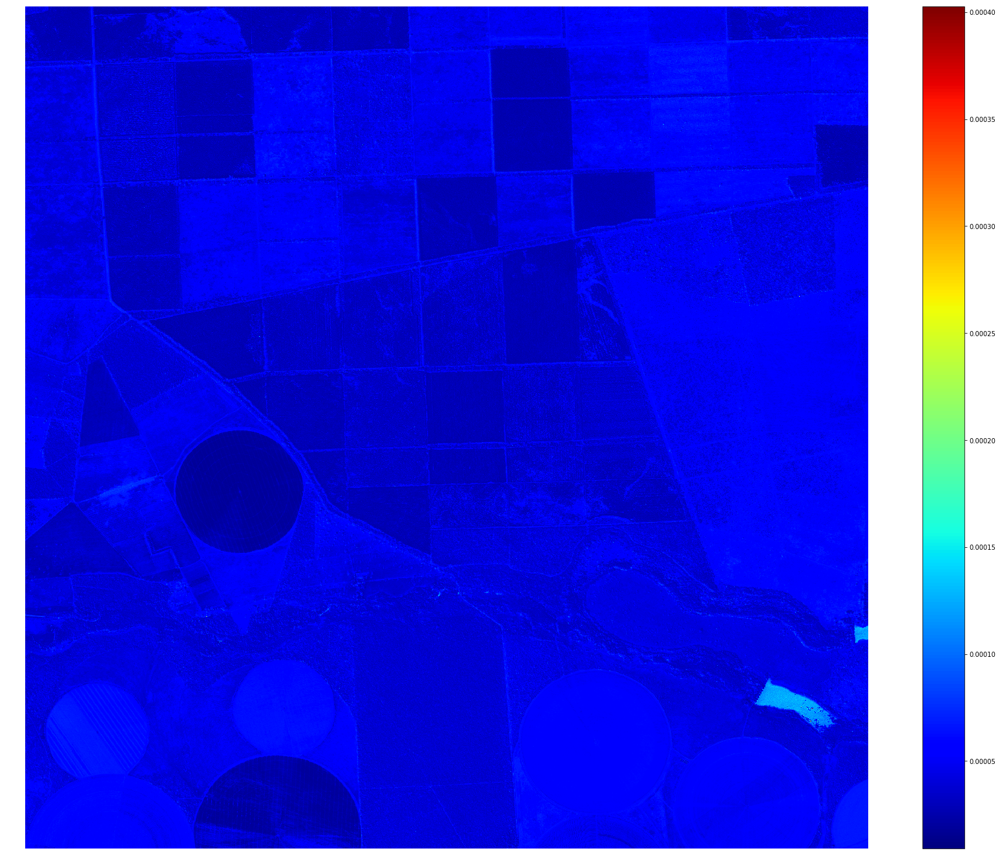

In [11]:
tredred = calc_ecarr_redred(e)
plot(tredred)

In [ ]:
e.quantile()

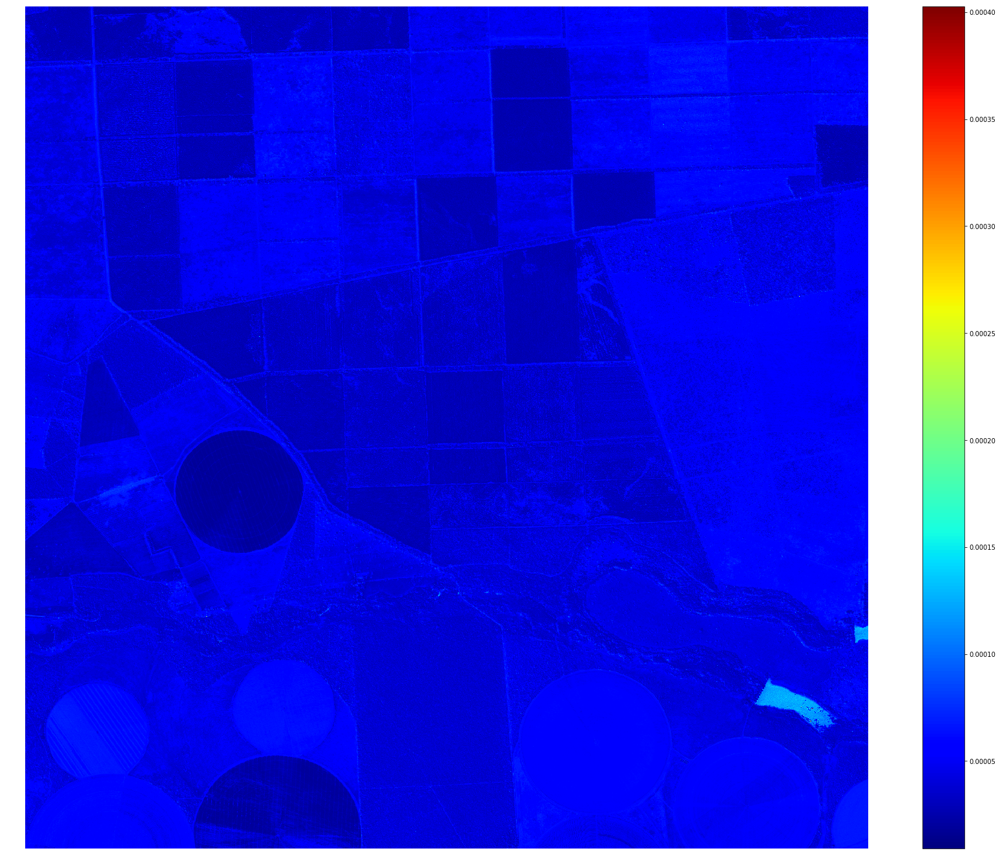

In [10]:
bands = ["coastal","Blue", "Green", "Yellow","red", "Rededge","nir1","near-IR2"]
def calc_ecarr_redred(cimg):
    green = cimg[2,:,:]
    red = cimg[4,:,:]
    rededge = cimg[5,:,:]
    ecarr = 0.0161 * ((red/(green*rededge)) ** 0.7784)
    return(ecarr)

tredred = calc_ecarr_redred(e)
plot(tredred)

In [54]:
import dask.array as da
#import numpy as np
x = da.from_array(tredred, chunks=10)
h, bins = da.histogram(x, bins=10, range=[0, 0.0002])

h.compute()


array([      7,     474,   70675,  746828, 2345764, 2358201,  543410,
         15764,      28,       5])

In [73]:
import dask.array as da

x = da.from_array(tredred, chunks=10)
h, bins = da.histogram(x, bins=100, range=[0, 0.0002])
myhistarr = h.compute()

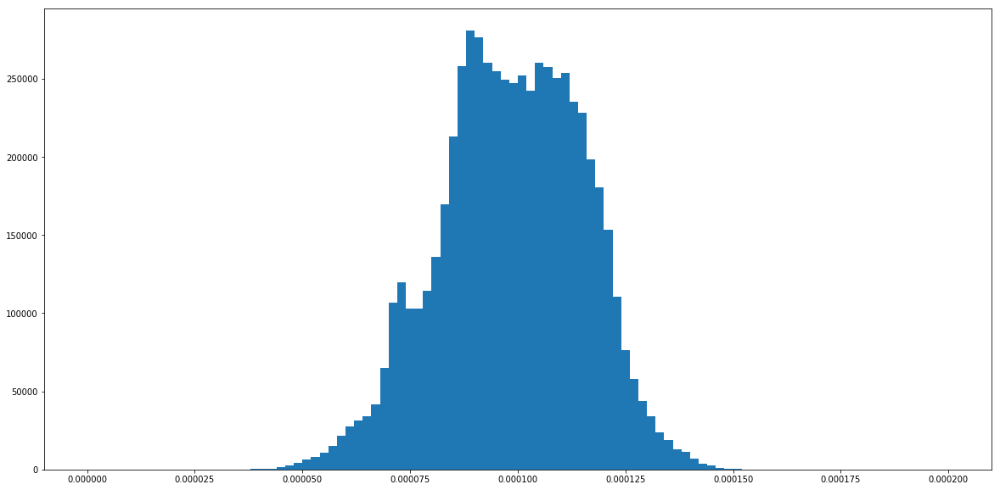

In [79]:
import numpy as np
import matplotlib.pyplot as plt

counts = myhistarr
centroids = (bins[1:] + bins[:-1]) / 2
plt.figure(figsize=(20, 10))
counts_, bins_, _ = plt.hist(centroids, bins=len(counts),
                             weights=counts, range=(min(bins), max(bins)))

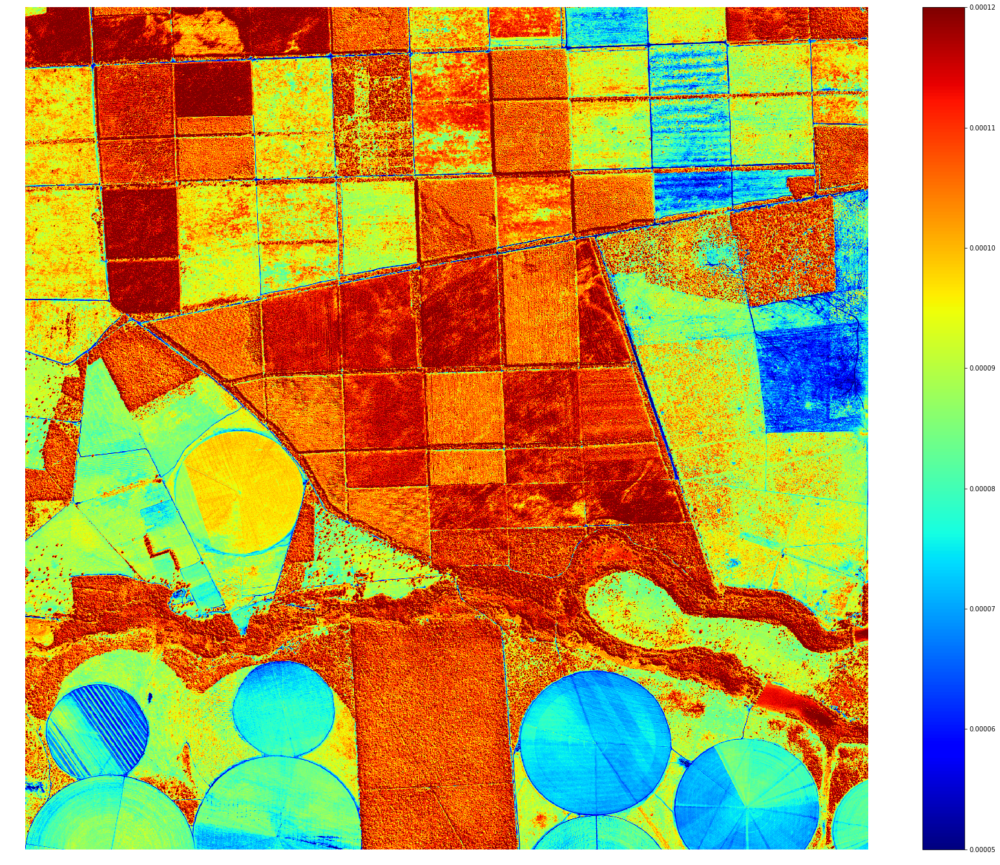

In [116]:
# Clipped red/red ECARR index:
climplot(tredred,0.00005,0.00012)

The following cell plots the raw image, the trimmed ECARR index image, and the ndvi index image. 

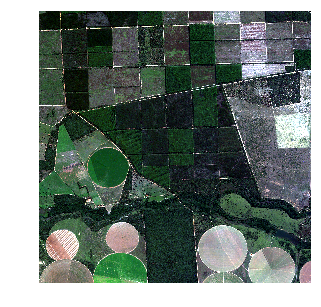

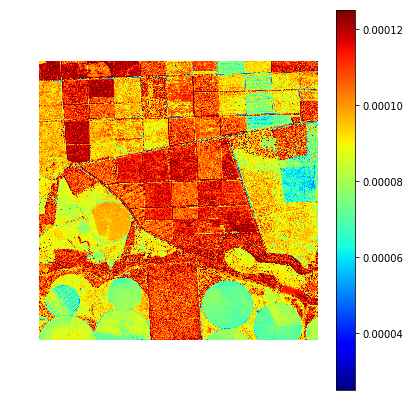

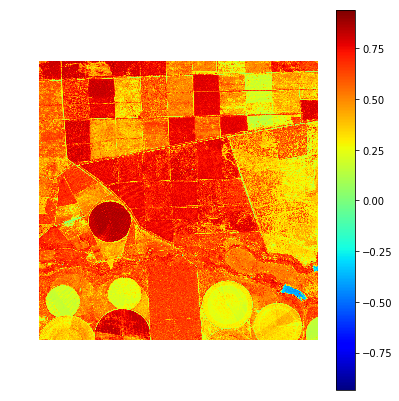

In [112]:
e.plot(w=5,h=5)
climplot(tredred,0.000025,0.000125,w=6.25,h=7)
plot(pndvi,w=6.25,h=7)

The following documents something surprising; using the red edge band rather than the red band does not seem to improve the 
ability of the ECARR index to discrimate eucalypt from non-eucalypt vegetation.  Additionally, use of the red edge band seems to 
tilt the ECARR index towards identifying bodies of water.

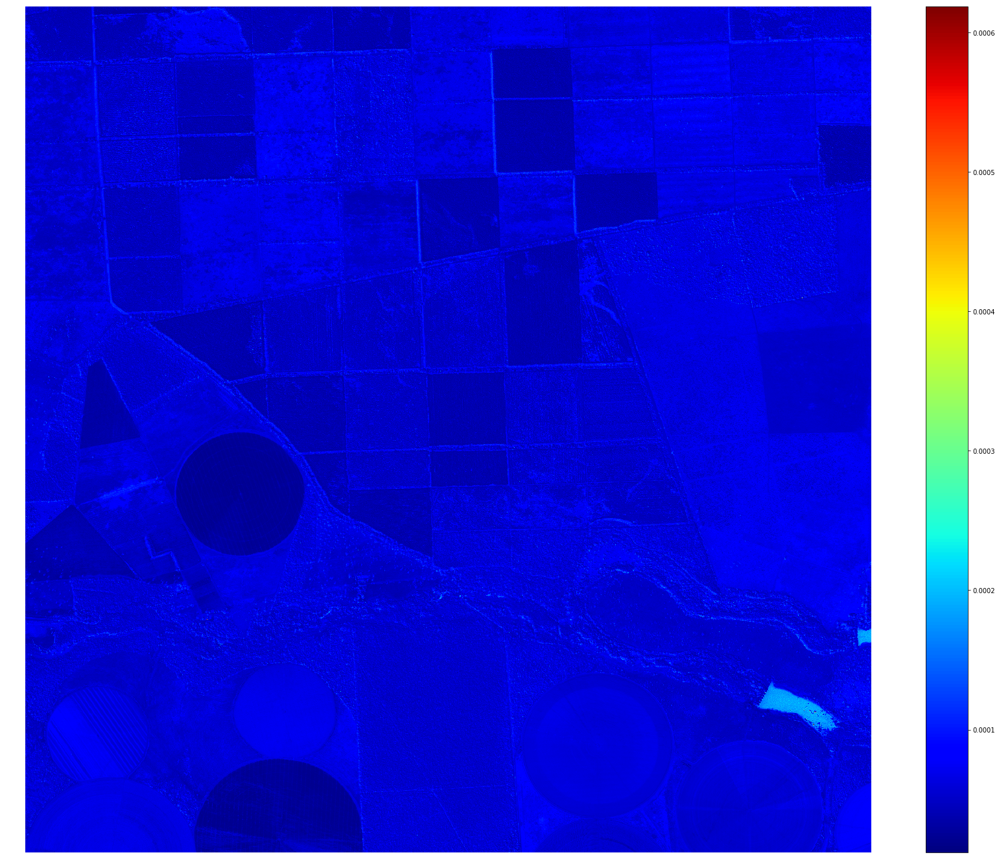

In [84]:
def calc_ecarr_red(cimg):
    green = cimg[2,:,:]
    red = cimg[4,:,:]
    rededge = cimg[5,:,:]
    ecarr = 0.0161 * ((red/(green*rededge)) ** 0.7784)
    return(ecarr)

tredrededge = calc_ecarr_red(e)
plot(tredrededge)

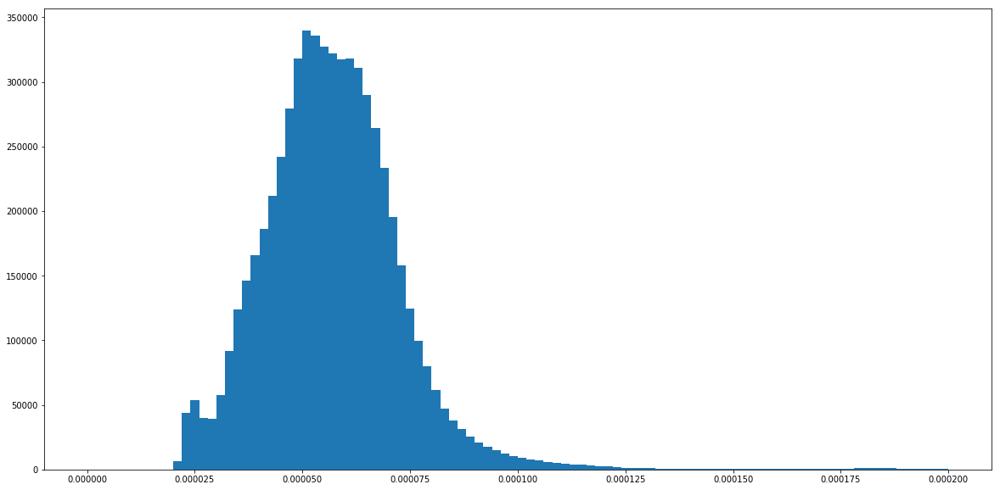

In [86]:
#import dask.array as da
#import numpy as np
x = da.from_array(tredrededge, chunks=10)
h, bins = da.histogram(x, bins=100, range=[0, 0.0002])

#bins = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9]).astype(float)
#counts = np.array([5, 3, 4, 5, 6, 1, 3, 7]).astype(float)
counts = h.compute()
centroids = (bins[1:] + bins[:-1]) / 2

import matplotlib.pyplot as plt
plt.figure(figsize=(20, 10))
counts_, bins_, _ = plt.hist(centroids, bins=len(counts),
                             weights=counts, range=(min(bins), max(bins)))

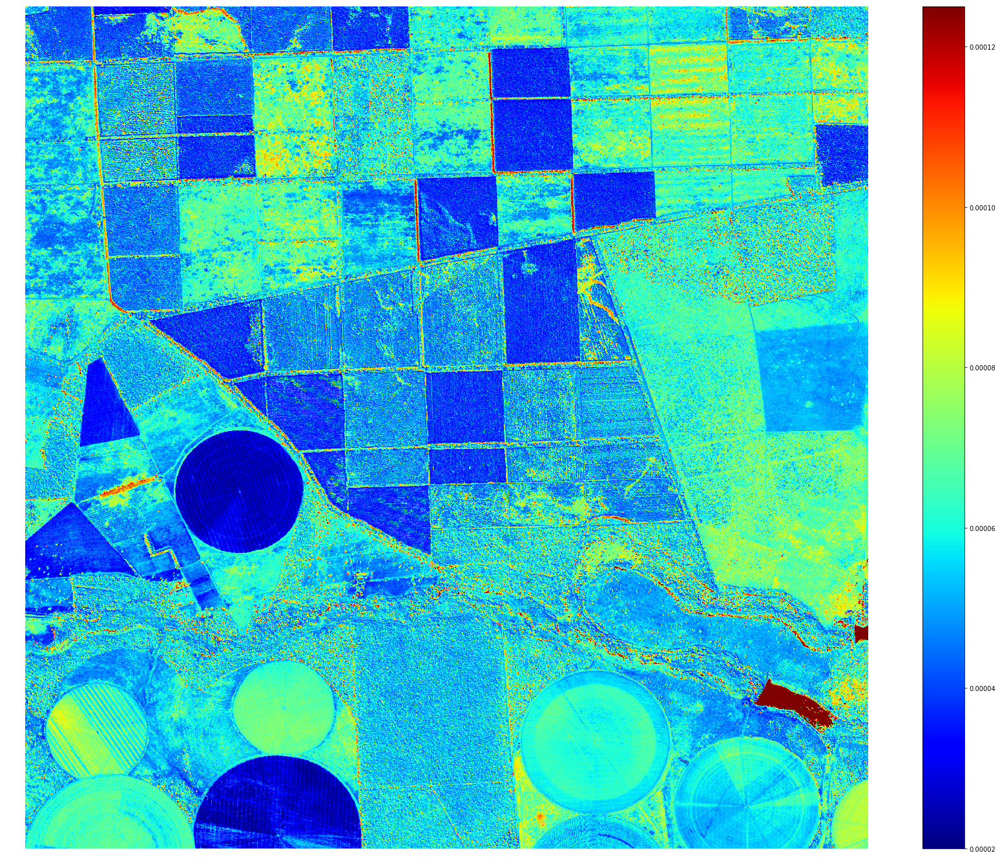

In [93]:
climplot(tredrededge,0.00002,0.000125)

In [ ]:
import matplotlib.pyplot as plt
#Multispectral 4-band: 4 standard VNIR colors are blue, green, red, near-IR1
#Multispectral 8-band: 4 additional VNIR colors are coastal, yellow, red edge, and near-IR2
bands = ["coastal","Blue", "Green", "Yellow","red", "Rededge","nir1","near-IR2"]
plt.figure(figsize=(20,20))
for i in range(8):
    plt.subplot(3, 3, i+1)
    plt.axis('off')
    plt.imshow(e[i,...], cmap="jet")
    plt.title("{} Band".format(bands[i]))
plt.show()